In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split
import numpy as np

import matplotlib.pyplot as plt
from tqdm import tqdm
import random

In [2]:
# torch.manual_seed(42)
# np.random.seed(42)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

# Dataset

## Load Gun Point dataset

In [ ]:
# !pip install -U aeon
from aeon.datasets import load_classification
X, y = load_classification(name="GunPoint")

### Convert time series into images

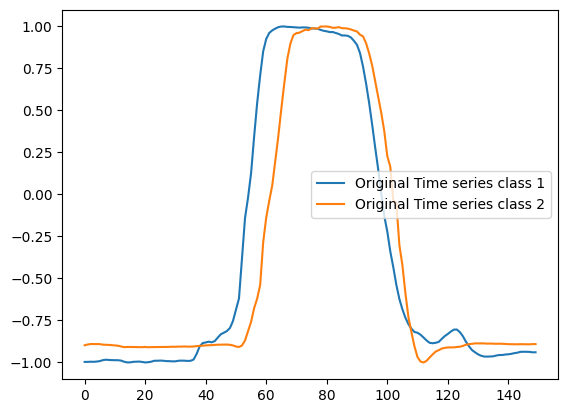

In [ ]:
#Normalise
a=-1
b=1
X_normalized = []
for el in X :
  max = np.max(el)
  min = np.min(el)
  X_normalized.append((el - min) / (max - min) * (b - a) + a)

time_series_class_2 = X_normalized[0]
time_series_class_1 = X_normalized[2]


plt.plot(time_series_class_1[0], label=f'Original Time series class 1')
plt.plot(time_series_class_2[0], label=f'Original Time series class 2')
plt.legend()

In [ ]:
!pip install -U pyts
from pyts.image import GramianAngularField

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 13.3 MB/s eta 0:00:00


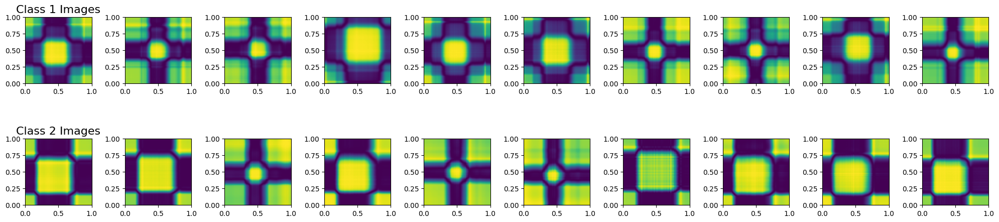

In [ ]:
import random
# Set parameters for Gramian Angular Field
image_size = 1.0
sample_range = (-1, 1)
method = 'summation'  # Other options: 'difference', 'product', 'double_summation'

# Create Gramian Angular Field transformer
gaf = GramianAngularField(image_size=image_size, sample_range=sample_range, method=method)

# Transform time series to GAF
gaf_images_X = []
for el in X_normalized:
  gaf_images_X.append(gaf.fit_transform(el))
gaf_images_X = np.array(gaf_images_X)

#Get index of class 1
index_1 = [index for index, value in enumerate(y) if value == '1']
index_2 = [index for index, value in enumerate(y) if value == '2']

gaf_image_class_1 = random.sample(list(gaf_images_X[index_1]),10)
gaf_image_class_2 = random.sample(list(gaf_images_X[index_2]),10)

# Create subplots for Class 1
fig, axs = plt.subplots(2, 10, figsize=(20, 5))
for i in range(10):
    axs[0, i].imshow(gaf_image_class_1[i][0], cmap='viridis', origin='lower', extent=[0, 1, 0, 1])

# Create subplots for Class 2
for i in range(10):
    axs[1, i].imshow(gaf_image_class_2[i][0], cmap='viridis', origin='lower', extent=[0, 1, 0, 1])

# Set titles for each row
axs[0, 0].set_title('Class 1 Images', fontsize=16)
axs[1, 0].set_title('Class 2 Images', fontsize=16)

# Adjust layout
plt.tight_layout()
plt.show()

In [ ]:
print(gaf_images_X.shape)
gaf_images_X[0].shape

(200, 1, 150, 150)


(1, 150, 150)

### Normalize gaf images

In [ ]:
gaf_images_X_normalized = (gaf_images_X + 1) / 2.0
print(np.min(gaf_images_X_normalized[0,0]))

0.0


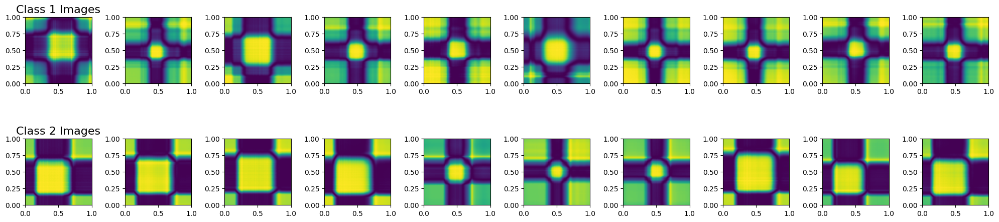

In [ ]:
gaf_image_class_1 = random.sample(list(gaf_images_X_normalized[index_1]),10)
gaf_image_class_2 = random.sample(list(gaf_images_X_normalized[index_2]),10)

# Create subplots for Class 1
fig, axs = plt.subplots(2, 10, figsize=(20, 5))
for i in range(10):
    axs[0, i].imshow(gaf_image_class_1[i][0], cmap='viridis', origin='lower', extent=[0, 1, 0, 1])

# Create subplots for Class 2
for i in range(10):
    axs[1, i].imshow(gaf_image_class_2[i][0], cmap='viridis', origin='lower', extent=[0, 1, 0, 1])

# Set titles for each row
axs[0, 0].set_title('Class 1 Images', fontsize=16)
axs[1, 0].set_title('Class 2 Images', fontsize=16)

# Adjust layout
plt.tight_layout()
plt.show()

## Load Middle Phalanx dataset

In [3]:
train_file = "MiddlePhalanxTW_TRAIN.txt"
test_file = "MiddlePhalanxTW_TEST.txt"

# Load training data
train_data = np.loadtxt(train_file)
train_X = train_data[:, 1:]  # Exclude the first column (class ID)
train_y = train_data[:, 0]  # Extract the class ID

# Load test data
test_data = np.loadtxt(test_file)
test_X = test_data[:, 1:]  # Exclude the first column (class ID)
test_y = test_data[:, 0]  # Extract the class ID

#Put labels between 0 and 5
train_y = train_y - 3
test_y = test_y - 3

#Expand dimensions
train_X=np.expand_dims(train_X, axis=1)
test_X=np.expand_dims(test_X, axis=1)

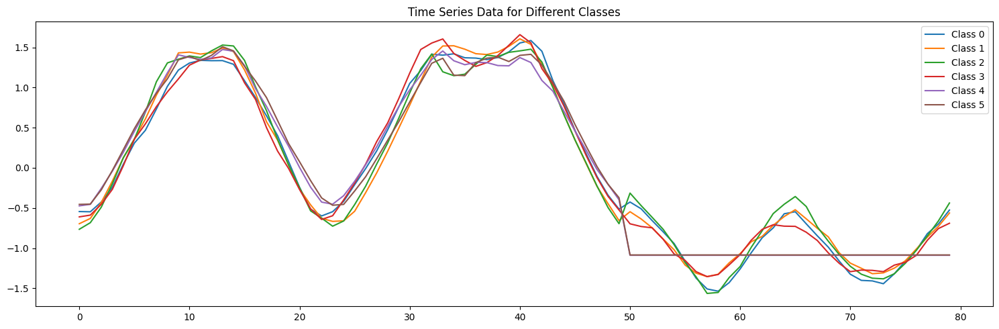

In [4]:
# Get unique classes
unique_classes = np.unique(train_y)

# Create subplots for all classes
fig, ax = plt.subplots(figsize=(15, 5))

# Iterate over each class
for class_label in unique_classes:
    # Get indices of samples belonging to the current class
    indices = np.where(train_y == class_label)[0]
    # Randomly select a sample from the class
    random_index = random.choice(indices)
    # Get the corresponding time series data
    time_series = train_X[random_index][0]
    # Plot the time series
    ax.plot(time_series, label=f"Class {int(class_label)}")

# Set title and legend
ax.set_title("Time Series Data for Different Classes")
ax.legend()

# Adjust layout
plt.tight_layout()
plt.show()


In [5]:
!pip install -U pyts
from pyts.image import GramianAngularField

### Gramian Angular Field

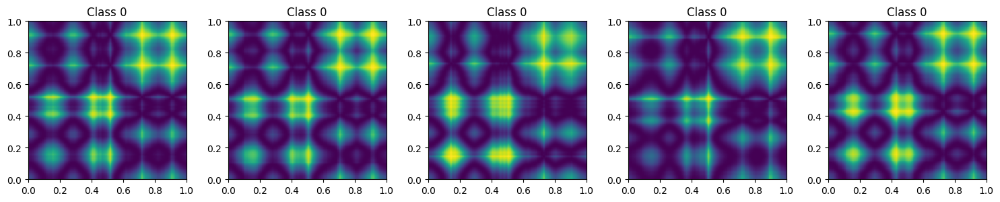

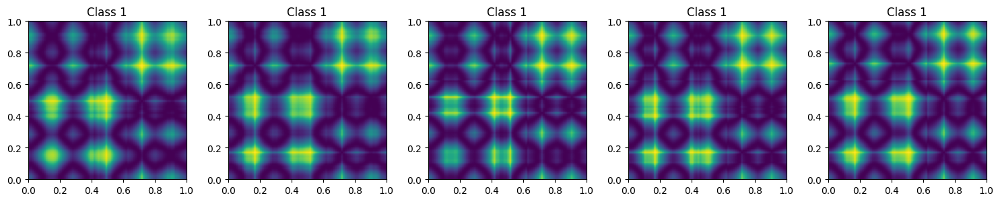

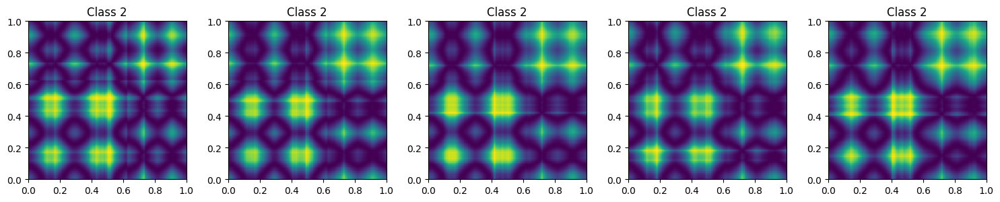

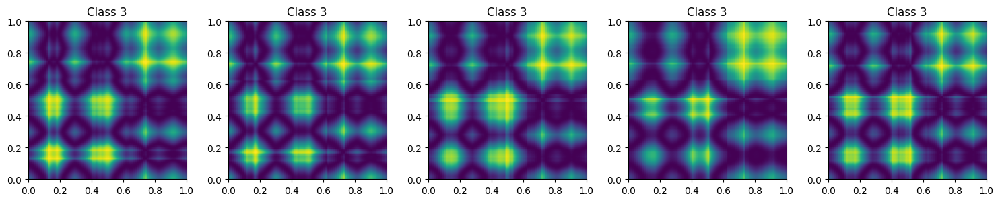

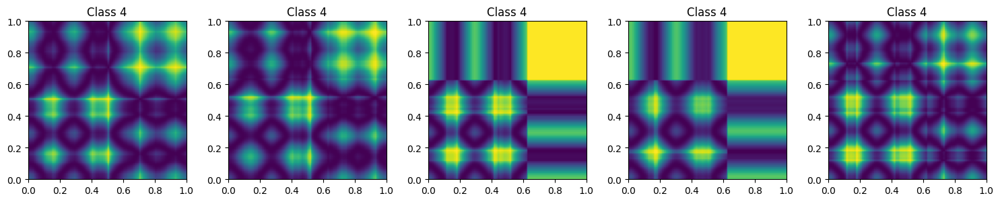

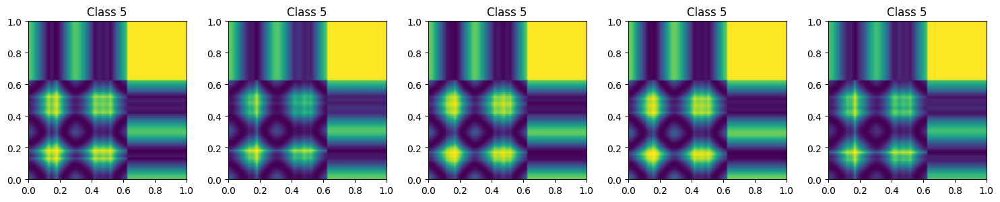

In [6]:
# Set parameters for Gramian Angular Field
image_size = 1.0
sample_range = (-1, 1)
method = 'summation'  # Other options: 'difference', 'product', 'double_summation'

# Create Gramian Angular Field transformer
gaf = GramianAngularField(image_size=image_size, sample_range=sample_range, method=method)

# Transform time series to GAF
gaf_images_train_X = []
for el in train_X:
  gaf_images_train_X.append(gaf.fit_transform(el))
gaf_images_train_X = np.array(gaf_images_train_X)

# Transform test time series to MTF
gaf_images_test_X = []
for el in test_X:
  gaf_images_test_X.append(gaf.fit_transform(el))
gaf_images_test_X = np.array(gaf_images_test_X)

# Iterate over each class
for class_label in unique_classes:
    # Get indices of samples belonging to the current class
    indices = np.where(train_y == class_label)[0]
    # Randomly select a sample from the class
    n = 5  # Number of samples to randomly select
    random_indexes = random.sample(list(indices), n)
    # Get the corresponding time series data
    class_gaf_images = gaf_images_train_X[random_indexes]
    # Create subplots for the current class
    fig, axs = plt.subplots(1, n, figsize=(15, 5))
    # Iterate over each random index
    for i, random_index in enumerate(random_indexes):
        # Plot the GAF image
        axs[i].imshow(class_gaf_images[i][0], cmap='viridis', origin='lower', extent=[0, 1, 0, 1])
        # Set title
        axs[i].set_title(f"Class {int(class_label)}")
    # Adjust layout
    plt.tight_layout()
    plt.show()

### Markov Transition Field

In [6]:
from pyts.image import MarkovTransitionField

# CreateMarkovTransitionField transformer
mtf = MarkovTransitionField(image_size=1., n_bins=8)

# Transform train time series to MTF
mtf_images_train_X = []
for el in train_X:
  mtf_images_train_X.append(mtf.fit_transform(el))
mtf_images_train_X = np.array(mtf_images_train_X)

# Transform test time series to MTF
mtf_images_test_X = []
for el in test_X:
  mtf_images_test_X.append(mtf.fit_transform(el))
mtf_images_test_X = np.array(mtf_images_test_X)

c:\Users\loren\AppData\Local\Programs\Python\Python310\lib\site-packages\pyts\preprocessing\discretizer.py:168: UserWarning: Some quantiles are equal. The number of bins will be smaller for sample [0]. Consider decreasing the number of bins or removing these samples.
  warn("Some quantiles are equal. The number of bins will "
c:\Users\loren\AppData\Local\Programs\Python\Python310\lib\site-packages\pyts\preprocessing\discretizer.py:168: UserWarning: Some quantiles are equal. The number of bins will be smaller for sample [0]. Consider decreasing the number of bins or removing these samples.
  warn("Some quantiles are equal. The number of bins will "
c:\Users\loren\AppData\Local\Programs\Python\Python310\lib\site-packages\pyts\preprocessing\discretizer.py:168: UserWarning: Some quantiles are equal. The number of bins will be smaller for sample [0]. Consider decreasing the number of bins or removing these samples.
  warn("Some quantiles are equal. The number of bins will "
c:\Users\loren\A

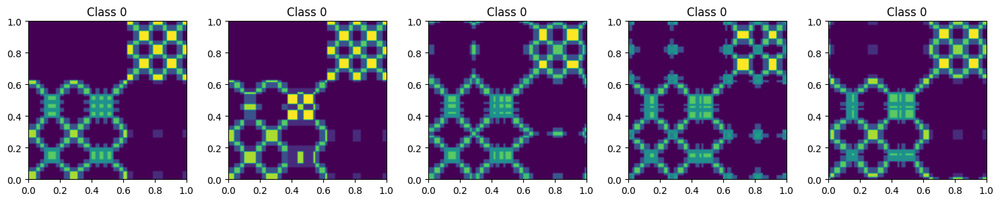

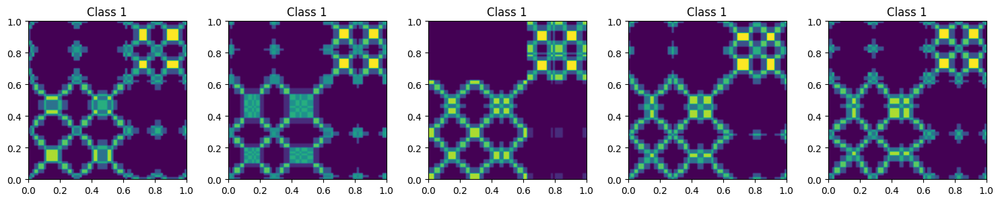

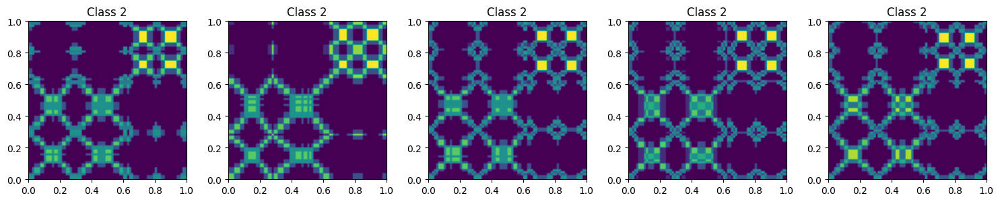

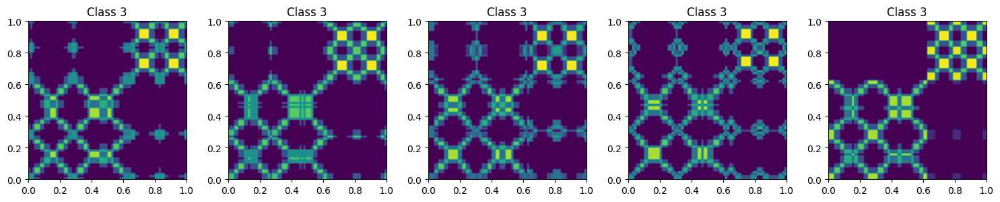

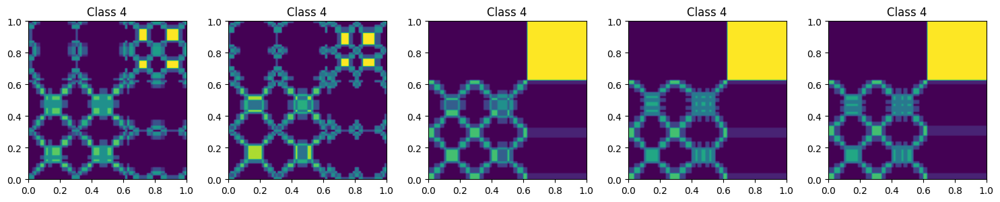

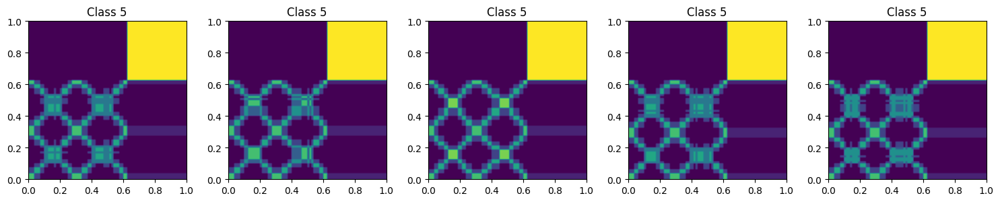

In [7]:
# Iterate over each class
for class_label in unique_classes:
    # Get indices of samples belonging to the current class
    indices = np.where(train_y == class_label)[0]
    # Randomly select a sample from the class
    n = 5  # Number of samples to randomly select
    random_indexes = random.sample(list(indices), n)
    # Get the corresponding time series data
    class_mtf_images = mtf_images_train_X[random_indexes]
    # Create subplots for the current class
    fig, axs = plt.subplots(1, n, figsize=(15, 5))
    # Iterate over each random index
    for i, random_index in enumerate(random_indexes):
        # Plot the GAF image
        axs[i].imshow(class_mtf_images[i][0], cmap='viridis', origin='lower', extent=[0, 1, 0, 1])
        # Set title
        axs[i].set_title(f"Class {int(class_label)}")
    # Adjust layout
    plt.tight_layout()
    plt.show()

In [8]:
print(np.max(mtf_images_train_X), np.min(mtf_images_train_X))

1.0 0.0


## Load ArrowHead


In [82]:
from aeon.datasets import load_classification
X, y = load_classification(name="ArrowHead")

In [83]:
#Normalise
a=-1
b=1
X_normalized = []
for el in X :
  max = np.max(el)
  min = np.min(el)
  X_normalized.append((el - min) / (max - min) * (b - a) + a)

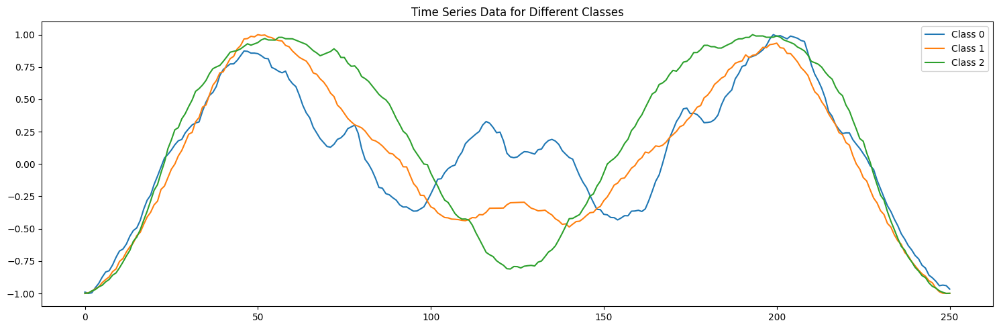

In [106]:
train_X = X_normalized
train_y = y
# Get unique classes
unique_classes = np.unique(train_y)

# Create subplots for all classes
fig, ax = plt.subplots(figsize=(15, 5))

# Iterate over each class
for class_label in unique_classes:
    # Get indices of samples belonging to the current class
    indices = np.where(train_y == class_label)[0]
    # Randomly select a sample from the class
    random_index = random.choice(indices)
    # Get the corresponding time series data
    time_series = train_X[random_index][0]
    # Plot the time series
    ax.plot(time_series, label=f"Class {int(class_label)}")

# Set title and legend
ax.set_title("Time Series Data for Different Classes")
ax.legend()

# Adjust layout
plt.tight_layout()
plt.show()

In [88]:
len(train_X)

211

In [114]:
from pyts.image import MarkovTransitionField

# CreateMarkovTransitionField transformer
mtf = MarkovTransitionField(image_size=.9, n_bins=8)

# Transform train time series to MTF
mtf_images_train_X = []
for el in train_X:
  mtf_images_train_X.append(mtf.fit_transform(el))
mtf_images_train_X = np.array(mtf_images_train_X)

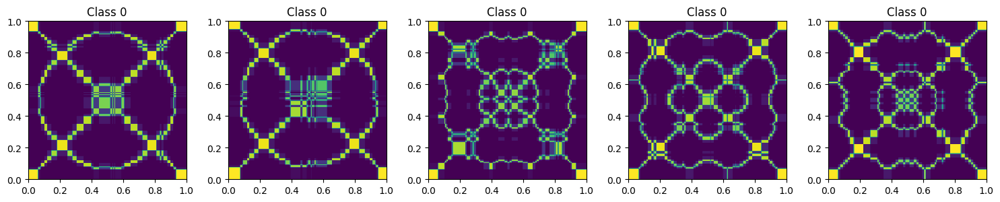

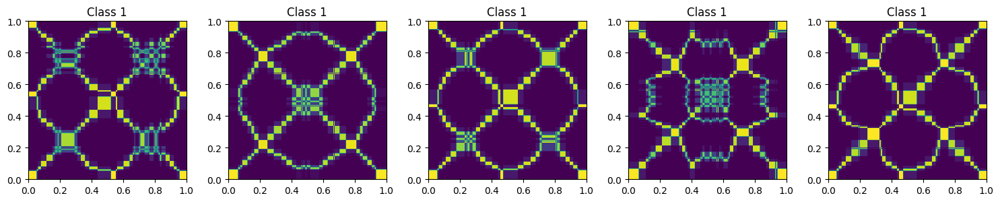

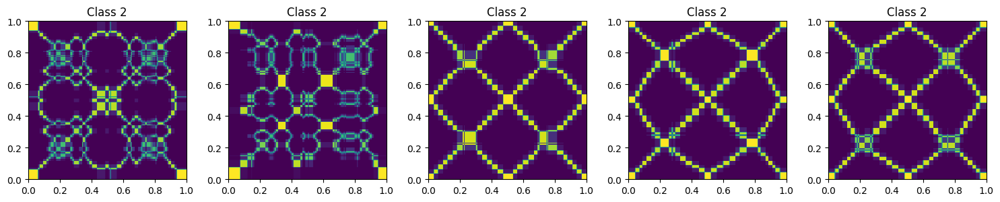

In [115]:
# Iterate over each class
for class_label in unique_classes:
    # Get indices of samples belonging to the current class
    indices = np.where(train_y == class_label)[0]
    # Randomly select a sample from the class
    n = 5  # Number of samples to randomly select
    random_indexes = random.sample(list(indices), n)
    # Get the corresponding time series data
    class_mtf_images = mtf_images_train_X[random_indexes]
    # Create subplots for the current class
    fig, axs = plt.subplots(1, n, figsize=(15, 5))
    # Iterate over each random index
    for i, random_index in enumerate(random_indexes):
        # Plot the GAF image
        axs[i].imshow(class_mtf_images[i][0], cmap='viridis', origin='lower', extent=[0, 1, 0, 1])
        # Set title
        axs[i].set_title(f"Class {int(class_label)}")
    # Adjust layout
    plt.tight_layout()
    plt.show()

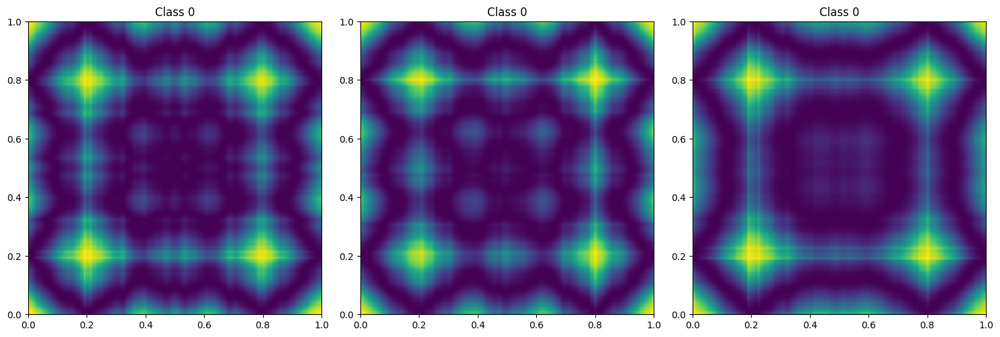

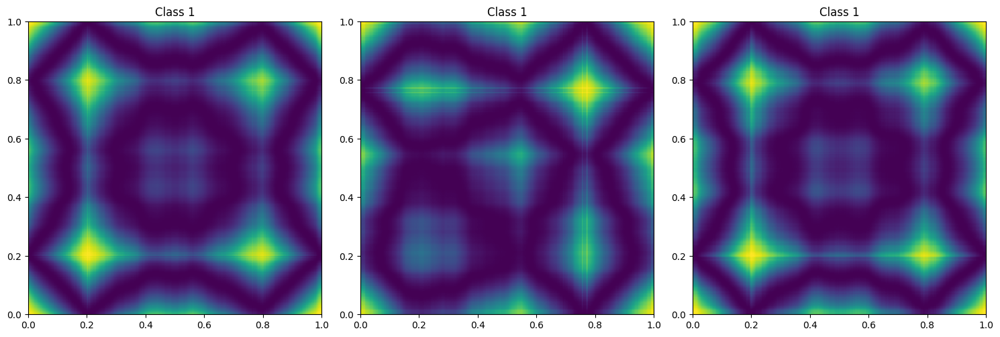

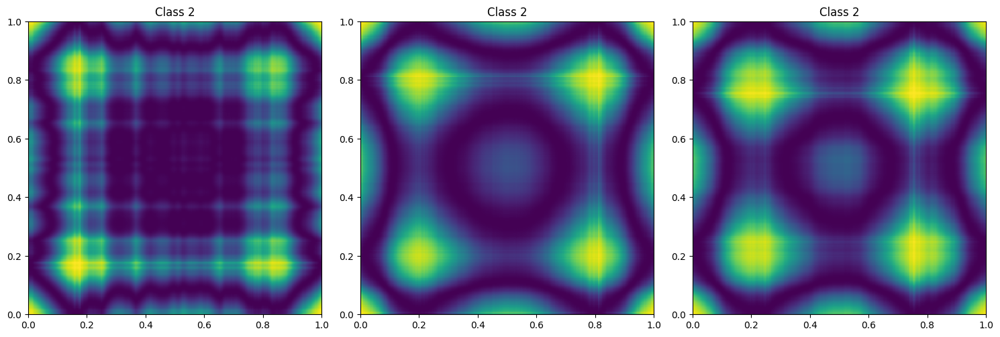

In [90]:
# !pip install -U pyts
from pyts.image import GramianAngularField
# Set parameters for Gramian Angular Field
image_size = 1.0
sample_range = (-1, 1)
method = 'summation'  # Other options: 'difference', 'product', 'double_summation'

# Create Gramian Angular Field transformer
gaf = GramianAngularField(image_size=image_size, sample_range=sample_range, method=method)

# Transform time series to GAF
gaf_images_train_X = []
for el in train_X:
  gaf_images_train_X.append(gaf.fit_transform(el))
gaf_images_train_X = np.array(gaf_images_train_X)

# # Transform test time series to MTF
# gaf_images_test_X = []
# for el in test_X:
#   gaf_images_test_X.append(gaf.fit_transform(el))
# gaf_images_test_X = np.array(gaf_images_test_X)

# Iterate over each class
for class_label in unique_classes:
    # Get indices of samples belonging to the current class
    indices = np.where(train_y == class_label)[0]
    # Randomly select a sample from the class
    n = 3  # Number of samples to randomly select
    random_indexes = random.sample(list(indices), n)
    # Get the corresponding time series data
    class_gaf_images = gaf_images_train_X[random_indexes]
    # Create subplots for the current class
    fig, axs = plt.subplots(1, n, figsize=(15, 5))
    # Iterate over each random index
    for i, random_index in enumerate(random_indexes):
        # Plot the GAF image
        axs[i].imshow(class_gaf_images[i][0], cmap='viridis', origin='lower', extent=[0, 1, 0, 1])
        # Set title
        axs[i].set_title(f"Class {int(class_label)}")
    # Adjust layout
    plt.tight_layout()
    plt.show()

# Train CGAN to generate images

### Create dataloaders GUNPOINT


In [ ]:
y_reduced = [int(x) for x in y]
###make y_labels one hot encoding
y_reduced_ohe = []
for el in y_reduced :
  if el == 1 :
    y_reduced_ohe.append([1,0])
  else :
    y_reduced_ohe.append([0,1])

In [ ]:
gaf_images_X_tensor = torch.tensor(gaf_images_X, dtype=torch.float32)
y_tensor = torch.tensor(y_reduced_ohe, dtype=torch.float32)

# X_train, X_test, y_train, y_test = train_test_split(gaf_images_X_tensor, y_tensor, test_size=0.05, random_state=42)
# train_dataset = TensorDataset(X_train, y_train)
# test_dataset = TensorDataset(X_test, y_test)
train_dataset = TensorDataset(gaf_images_X_tensor, y_tensor)
batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
# test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

### Create dataloaders Middle Phalanx

In [7]:
#One hot encoding of labels
unique_classes = np.unique(train_y)
n_classes = len(unique_classes)
#fro training
n_samples_train = len(train_y)
train_y_ohe = np.zeros((n_samples_train, n_classes))
for i in range(n_samples_train):
    train_y_ohe[i, int(train_y[i])] = 1

#fro testing
n_samples_test = len(test_y)
test_y_ohe = np.zeros((n_samples_test, n_classes))
for i in range(n_samples_test):
    test_y_ohe[i, int(test_y[i])] = 1

In [8]:
gaf_images_train_X_normalized = (gaf_images_train_X + 1.) / 2.0
print(np.min(gaf_images_train_X_normalized), np.max(gaf_images_train_X_normalized))

gaf_images_test_X_normalized = (gaf_images_test_X + 1.) / 2.0
print(np.min(gaf_images_test_X_normalized), np.max(gaf_images_test_X_normalized))

-2.220446049250313e-16 1.0000000000000004
-2.220446049250313e-16 1.0000000000000004


In [9]:
train_X_image_tensor = torch.tensor(gaf_images_train_X, dtype=torch.float32)
train_y_tensor = torch.tensor(train_y_ohe, dtype=torch.float32)
test_X_image_tensor = torch.tensor(gaf_images_test_X, dtype=torch.float32)
test_y_tensor = torch.tensor(test_y_ohe, dtype=torch.float32)

batch_size = 32

train_dataset = TensorDataset(torch.cat([train_X_image_tensor,test_X_image_tensor]), torch.cat([train_y_tensor,test_y_tensor]))
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
# train_dataset = TensorDataset(train_X_image_tensor, train_y_tensor)
# test_dataset = TensorDataset(test_X_image_tensor, test_y_tensor)

# batch_size = 32

# train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
# test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

## Definition of the model

### Model 1 : MLP

In [ ]:
class Generator(nn.Module):
    def __init__(self, latent_dim, out_shape, num_classes):
        super(Generator, self).__init__()

        self.label_emb = nn.Embedding(num_classes, num_classes)

        def block(in_feat, out_feat, normalize=True):
            layers = [nn.Linear(in_feat, out_feat)]
            if normalize:
                layers.append(nn.BatchNorm1d(out_feat, 0.8))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *block(latent_dim + num_classes**2, 128, normalize=False),
            *block(128, 256),
            *block(256, 512),
            *block(512, 1024),
            nn.Linear(1024, out_shape),
            nn.Tanh()
        )

    def forward(self, noise, labels):
        # Concatenate label embedding and image to produce input
        emb = self.label_emb(labels)
        emb = emb.view(len(emb),-1)
        gen_input = torch.cat((emb, noise), -1)
        img = self.model(gen_input)
        return img


class Discriminator(nn.Module):
    def __init__(self,in_shape,num_classes):
        super(Discriminator, self).__init__()

        self.label_embedding = nn.Embedding(num_classes, num_classes)

        self.model = nn.Sequential(
            nn.Linear(num_classes**2 +in_shape, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 512),
            nn.Dropout(0.4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 512),
            nn.Dropout(0.4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 1),
        )

    def forward(self, img, labels):
        emb = self.label_embedding(labels)
        emb = emb.view(len(emb),-1)
        # Concatenate label embedding and image to produce input
        d_in = torch.cat((img.view(img.size(0), -1),emb), -1)
        validity = self.model(d_in)
        return validity


In [ ]:
# Set hyperparameters
latent_dim = 5
img_shape = int(np.prod(gaf_images_X[0].shape))
num_classes = 2
lr = 0.0001
b1 = 0.5
b2 = 0.999
epochs = 2000

In [ ]:
# Loss functions
adversarial_loss = torch.nn.MSELoss()
# Initialize generator and discriminator
generator = Generator(latent_dim, img_shape,num_classes)
discriminator = Discriminator(img_shape,num_classes)

generator.to(device)
discriminator.to(device)
adversarial_loss.to(device)

# Optimizers
optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(b1, b2))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(b1,b2))


### Model 2 : DCGAN - Transposed convolutions

In [ ]:
class Generator(nn.Module):
    def __init__(self,nz,ngf,nc, num_classes, embed_size):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(nz+embed_size*num_classes, ngf * 8, 5, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 5 x 5``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 3, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 9 x 9``
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 3, 2, 0, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 19 x 19``
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 38 x 38``
            nn.ConvTranspose2d(ngf, ngf, 3, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 75 x 75``
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 150 x 150``
        )

        self.embed = nn.Embedding(num_classes, embed_size)

    def forward(self, input, labels):
        embedding = self.embed(labels)
        embedding = embedding.view(len(embedding),-1).unsqueeze(2).unsqueeze(3)
        input = input.unsqueeze(2).unsqueeze(3)
        x = torch.cat([input, embedding], dim=1)
        return self.main(x)

class Discriminator(nn.Module):
    def __init__(self, nc, ndf, num_classes, img_size):
        super(Discriminator, self).__init__()
        self.img_size = img_size
        self.main = nn.Sequential(
            # input is ``(nc) x 150 x 150``
            nn.Conv2d(nc+num_classes, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 75 x 75``
            nn.Conv2d(ndf, ndf * 2, 3, 2, 2, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 38 x 38``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 19 x 19``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 9 x 9``
            nn.Conv2d(ndf * 8, 1, 4, 2, 0, bias=False),
            # state size. ``1 x 3 x 3``
            nn.Conv2d(1, 1, 3, 1, 0, bias=False),
            nn.Sigmoid()
        )

        self.embed = nn.Embedding(num_classes, img_size*img_size)

    def forward(self, input, labels):
        embedding = self.embed(labels).view(labels.shape[0],num_classes,self.img_size,self.img_size)
        x = torch.cat([input, embedding], dim=1)
        return self.main(x)


In [ ]:
# Set hyperparameters
img_size = gaf_images_X[0,0].shape[0]
num_classes = 2
lr = 0.0002
b1 = 0.5
b2 = 0.999
epochs = 2000

# Number of channels in the training images.
nc = 1

# Size of z latent vector (i.e. size of generator input)
latent_dim = 10
embed_size = 5
# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64



In [ ]:
# Loss functions
adversarial_loss = torch.nn.MSELoss()
# Initialize generator and discriminator
generator = Generator(nz=latent_dim, ngf=ngf,nc=nc, num_classes=num_classes, embed_size=embed_size)
discriminator = Discriminator(nc, ndf, num_classes, img_size)

generator.to(device)
discriminator.to(device)
adversarial_loss.to(device)

# Optimizers
optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(b1, b2))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(b1,b2))


### Model 3 : Upsample GAN - 150*150 ouput (Gunpoint)

In [26]:
# Random input tensor size
input_size = (1,1,38, 38)

# Random input tensor
random_input = torch.randn(*input_size)
# Upsample layer
upsample_layer = nn.Upsample(scale_factor=2, mode='nearest')  # Adjust scale_factor as needed
conv_layer = nn.Conv2d(1, 1, 3, 1, 3, bias=False)

# Forward pass
output = conv_layer(upsample_layer(random_input))
# Print original and upsampled tensor sizes
print(f"Original Input Size: {random_input.size()}")
print(f"Upsampled Output Size: {output.size()}")

Original Input Size: torch.Size([1, 1, 38, 38])
Upsampled Output Size: torch.Size([1, 1, 80, 80])


In [47]:
class Generator(nn.Module):
    def __init__(self, nz, ngf, nc, num_classes, embed_size):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.Upsample(scale_factor=5),
            nn.Conv2d(nz+embed_size*num_classes, ngf * 8, 3, 1, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 5 x 5``
            nn.Upsample(scale_factor=2),  # Upsample instead of ConvTranspose2d
            nn.Conv2d(ngf * 8, ngf * 4, 4, 1, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 9 x 9``
            nn.Upsample(scale_factor=2),  # Upsample instead of ConvTranspose2d
            nn.Conv2d(ngf * 4, ngf * 2, 4, 1, 2, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 19 x 19``
            nn.Upsample(scale_factor=2),  # Upsample instead of ConvTranspose2d
            nn.Conv2d(ngf * 2, ngf, 3, 1, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 38 x 38``
            nn.Upsample(scale_factor=2),  # Upsample instead of ConvTranspose2d
            nn.Conv2d(ngf, ngf, 4, 1, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 75 x 75``
            nn.Upsample(scale_factor=2),  # Upsample instead of ConvTranspose2d
            nn.Conv2d(ngf, nc, 3, 1, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 150 x 150``
            
        )

        self.embed = nn.Embedding(num_classes, embed_size)

    def forward(self, input, labels):
        embedding = self.embed(labels)
        embedding = embedding.view(len(embedding), -1).unsqueeze(2).unsqueeze(3)
        input = input.unsqueeze(2).unsqueeze(3)
        x = torch.cat([input, embedding], dim=1)
        return self.main(x)

class Discriminator(nn.Module):
    def __init__(self, nc, ndf, num_classes, img_size):
        super(Discriminator, self).__init__()
        self.img_size = img_size
        self.main = nn.Sequential(
            # input is ``(nc) x 150 x 150``
            nn.Conv2d(nc+num_classes, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 75 x 75``
            nn.Conv2d(ndf, ndf * 2, 3, 2, 2, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 38 x 38``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 19 x 19``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 9 x 9``
            nn.Conv2d(ndf * 8, 1, 4, 2, 0, bias=False),
            # state size. ``1 x 3 x 3``
            nn.Conv2d(1, 1, 3, 1, 0, bias=False),
            nn.Sigmoid()
        )

        self.embed = nn.Embedding(num_classes, img_size*img_size)

    def forward(self, input, labels):
        embedding = self.embed(labels).view(labels.shape[0],num_classes,self.img_size,self.img_size)
        x = torch.cat([input, embedding], dim=1)
        return self.main(x)


In [49]:
# Set hyperparameters
img_size = gaf_images_X[0,0].shape[0]
num_classes = 2
lr= 0.001
b1 = 0.5
b2 = 0.999
epochs = 300

# Number of channels in the training images.
nc = 1

# Size of z latent vector (i.e. size of generator input)
latent_dim = 50
embed_size = 10
# Size of feature maps in generator
ngf = 60

# Size of feature maps in discriminator
ndf = 64

In [50]:
# Loss functions
adversarial_loss = torch.nn.MSELoss()
# Initialize generator and discriminator
generator = Generator(nz=latent_dim, ngf=ngf,nc=nc, num_classes=num_classes, embed_size=embed_size)
discriminator = Discriminator(nc, ndf, num_classes, img_size)

generator.to(device)
discriminator.to(device)
adversarial_loss.to(device)

# Optimizers
optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(b1, b2))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(b1,b2))


### Model 4 - Upsample GAN output 80*80 Middle Phalanx

In [10]:
class Generator(nn.Module):
    def __init__(self, nz, ngf, nc, num_classes, embed_size):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.Upsample(scale_factor=5),
            nn.Conv2d(nz+embed_size*num_classes, ngf * 8, 3, 1, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 5 x 5``
            nn.Upsample(scale_factor=2),  # Upsample instead of ConvTranspose2d
            nn.Conv2d(ngf * 8, ngf * 4, 4, 1, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 9 x 9``
            nn.Upsample(scale_factor=2),  # Upsample instead of ConvTranspose2d
            nn.Conv2d(ngf * 4, ngf * 2, 4, 1, 2, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 19 x 19``
            nn.Upsample(scale_factor=2),  # Upsample instead of ConvTranspose2d
            nn.Conv2d(ngf * 2, ngf, 3, 1, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 38 x 38``
            nn.Upsample(scale_factor=2),  # Upsample instead of ConvTranspose2d
            nn.Conv2d(ngf, nc, 3, 1, 3, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 80 x 80``
            
        )

        self.embed = nn.Embedding(num_classes, embed_size)

    def forward(self, input, labels):
        embedding = self.embed(labels)
        embedding = embedding.view(len(embedding), -1).unsqueeze(2).unsqueeze(3)
        input = input.unsqueeze(2).unsqueeze(3)
        x = torch.cat([input, embedding], dim=1)
        return self.main(x)

class Discriminator(nn.Module):
    def __init__(self, nc, ndf, num_classes, img_size):
        super(Discriminator, self).__init__()
        self.img_size = img_size
        self.main = nn.Sequential(
            # input is ``(nc) x 80 x 80``
            nn.Conv2d(nc+num_classes, ndf, 5, 2, 0, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 38 x 38``
            nn.Conv2d(ndf, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 19 x 19``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 9 x 9``
            nn.Conv2d(ndf * 8, 1, 4, 2, 0, bias=False),
            # state size. ``1 x 3 x 3``
            nn.Conv2d(1, 1, 3, 1, 0, bias=False),
            nn.Sigmoid()
        )

        self.embed = nn.Embedding(num_classes, img_size*img_size)

    def forward(self, input, labels):
        embedding = self.embed(labels).view(labels.shape[0],num_classes,self.img_size,self.img_size)
        x = torch.cat([input, embedding], dim=1)
        return self.main(x)


In [31]:
# Set hyperparameters
img_size = train_X_image_tensor[0,0].shape[0]
num_classes = len(unique_classes)
lr= 0.00001
b1 = 0.5
b2 = 0.999
epochs = 1000

# Number of channels in the training images.
nc = 1

# Size of z latent vector (i.e. size of generator input)
latent_dim = 60
embed_size = 10
# Size of feature maps in generator
ngf = 85

# Size of feature maps in discriminator
ndf = 96

In [32]:
# Loss functions
adversarial_loss = torch.nn.MSELoss()
# Initialize generator and discriminator
generator = Generator(nz=latent_dim, ngf=ngf,nc=nc, num_classes=num_classes, embed_size=embed_size)
discriminator = Discriminator(nc, ndf, num_classes, img_size)

generator.to(device)
discriminator.to(device)
adversarial_loss.to(device)

# Optimizers
optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(b1, b2))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(b1,b2))


### Counting parameters


In [13]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

In [33]:
num_parameters_gen= count_parameters(generator)
num_parameters_disc=count_parameters(discriminator)

print(f"Number of parameters in the genrator: {num_parameters_gen}")
print(f"Number of parameters in the discriminator: {num_parameters_disc}")

Number of parameters in the genrator: 5491825
Number of parameters in the discriminator: 5378217


# Training


D_Loss: 0.11145465075969696,G_Loss: 0.4519791007041931 :   0%|          | 0/1000 [00:01<?, ?it/s] 

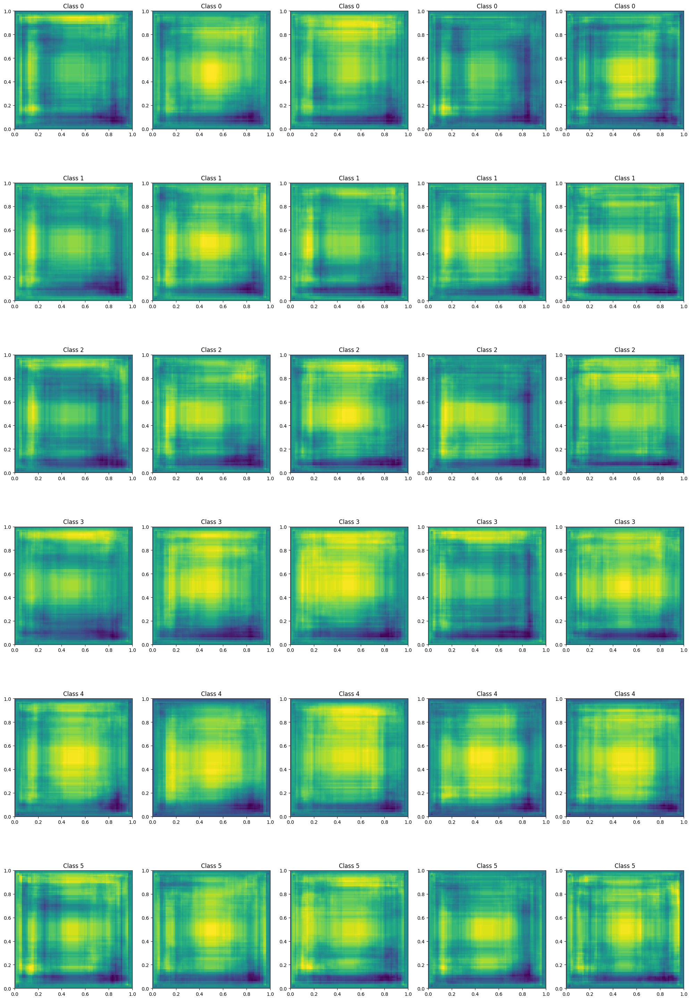

D_Loss: 0.15317954123020172,G_Loss: 0.20439541339874268 :   2%|▏         | 20/1000 [00:29<20:21,  1.25s/it] 

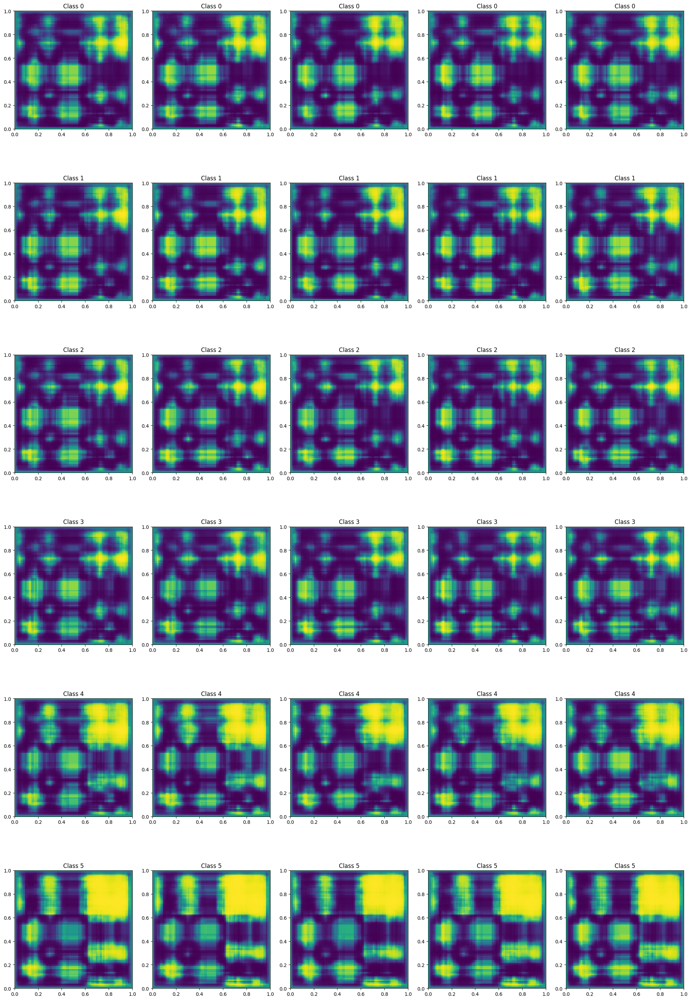

D_Loss: 0.008609679527580738,G_Loss: 0.757400631904602 :   4%|▍         | 40/1000 [00:56<19:10,  1.20s/it]  

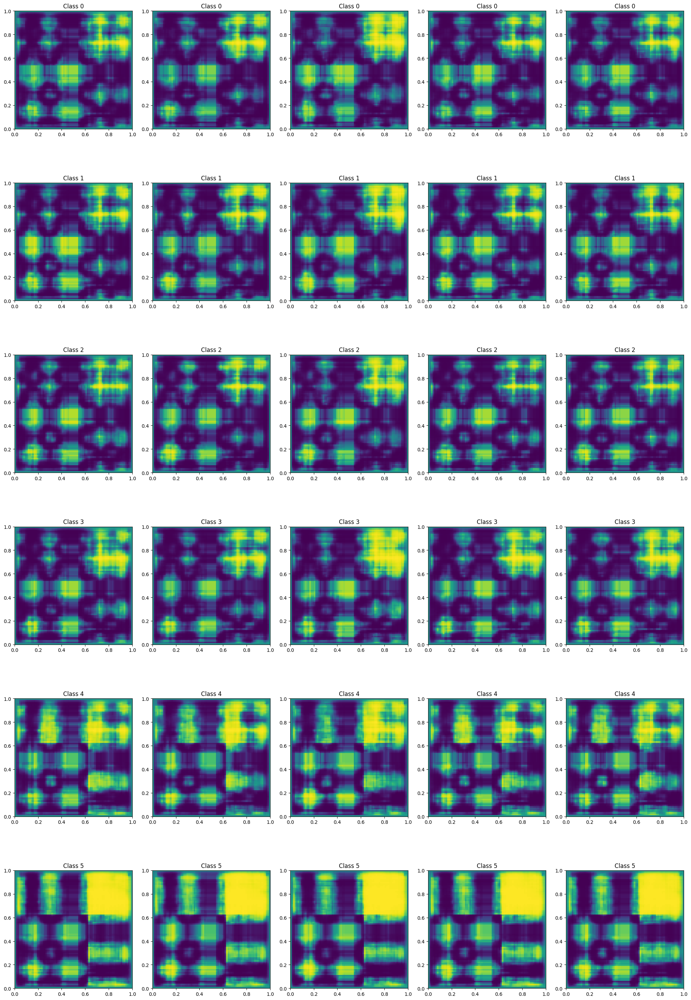

D_Loss: 0.0865793451666832,G_Loss: 0.9822447896003723 :   6%|▌         | 60/1000 [01:22<18:45,  1.20s/it]    

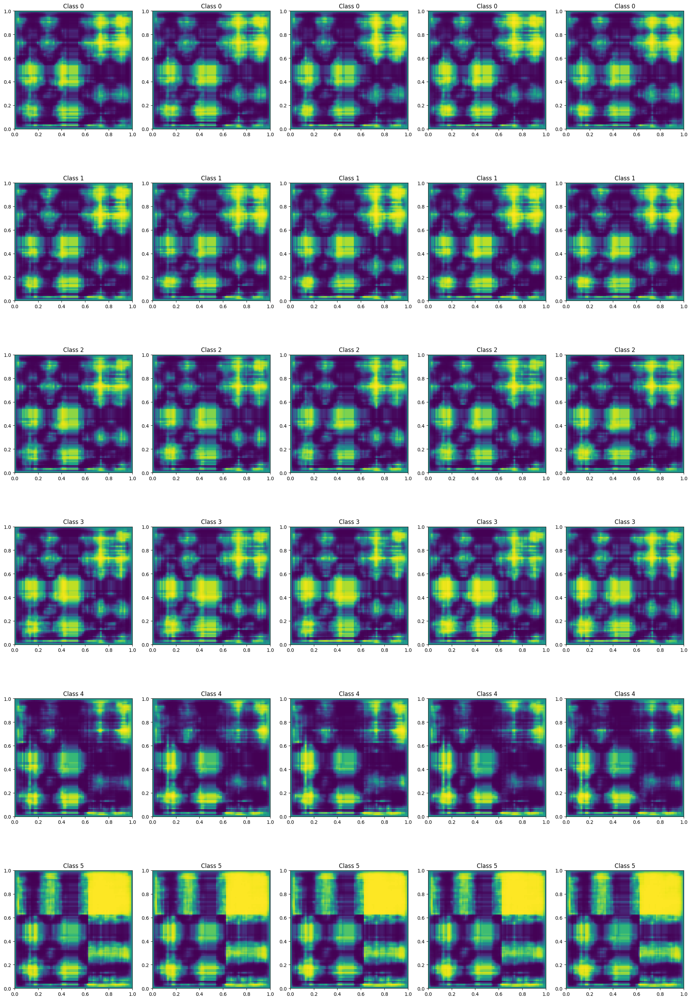

D_Loss: 0.00029501132667064667,G_Loss: 0.9719236493110657 :   8%|▊         | 80/1000 [01:49<18:22,  1.20s/it]

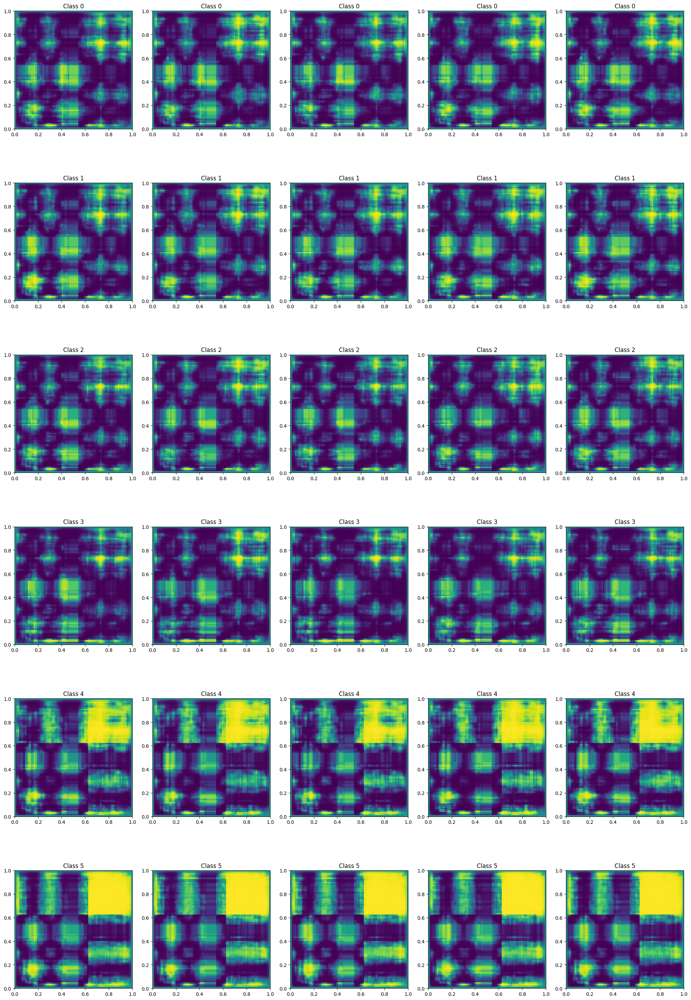

D_Loss: 0.00020720268366858363,G_Loss: 0.9853299260139465 :  10%|█         | 100/1000 [02:16<18:06,  1.21s/it]

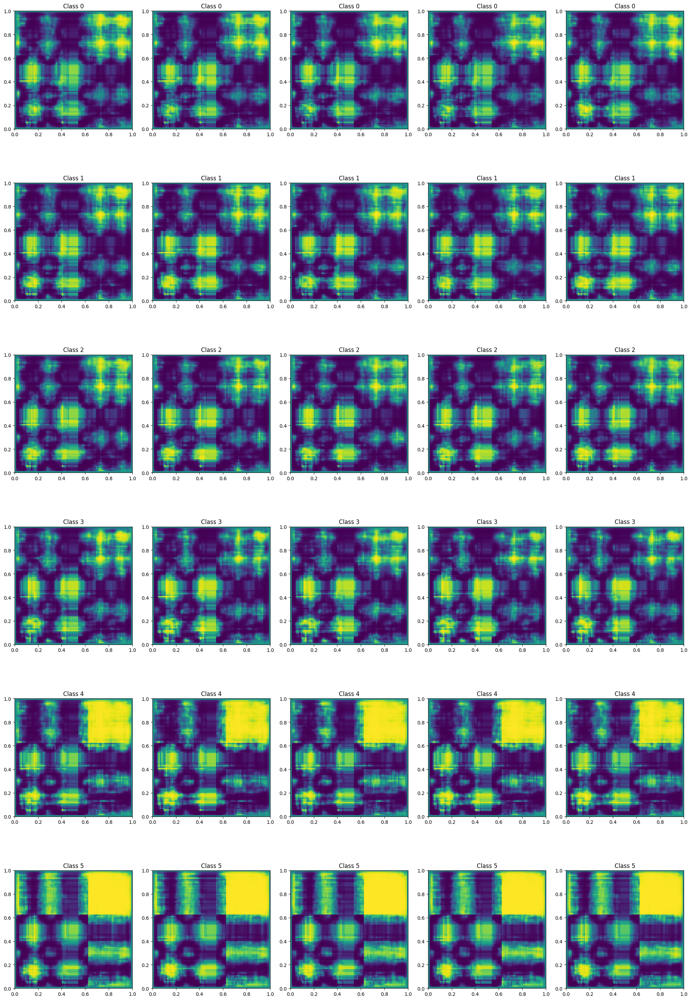

D_Loss: 0.0019241879926994443,G_Loss: 0.9977631568908691 :  12%|█▏        | 120/1000 [02:43<18:17,  1.25s/it] 

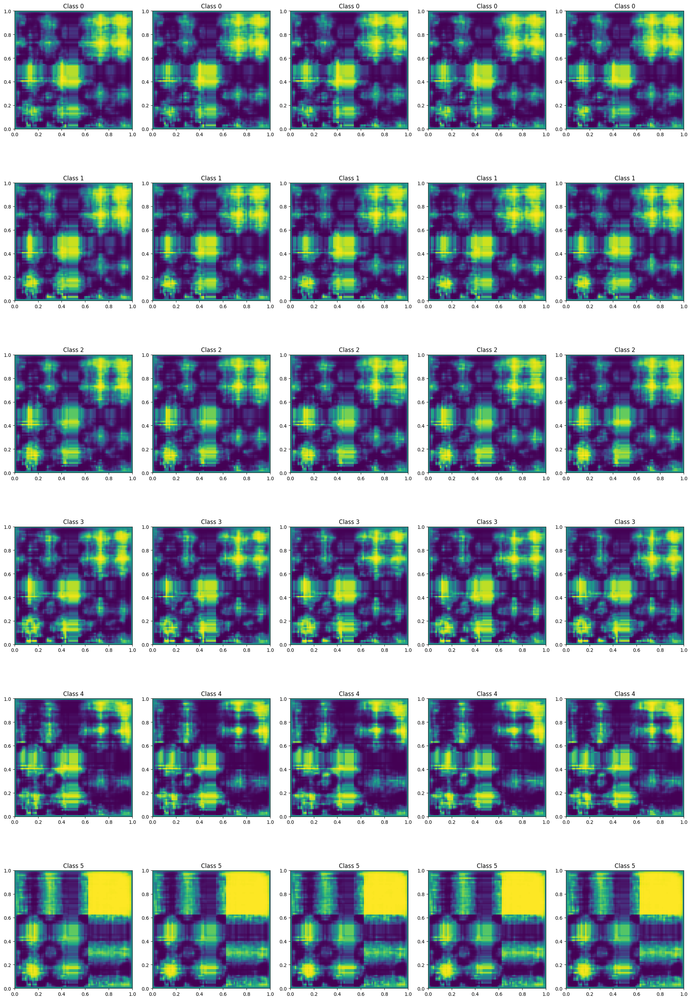

D_Loss: 4.615164016286144e-06,G_Loss: 0.9950204491615295 :  14%|█▍        | 140/1000 [03:09<17:08,  1.20s/it] 

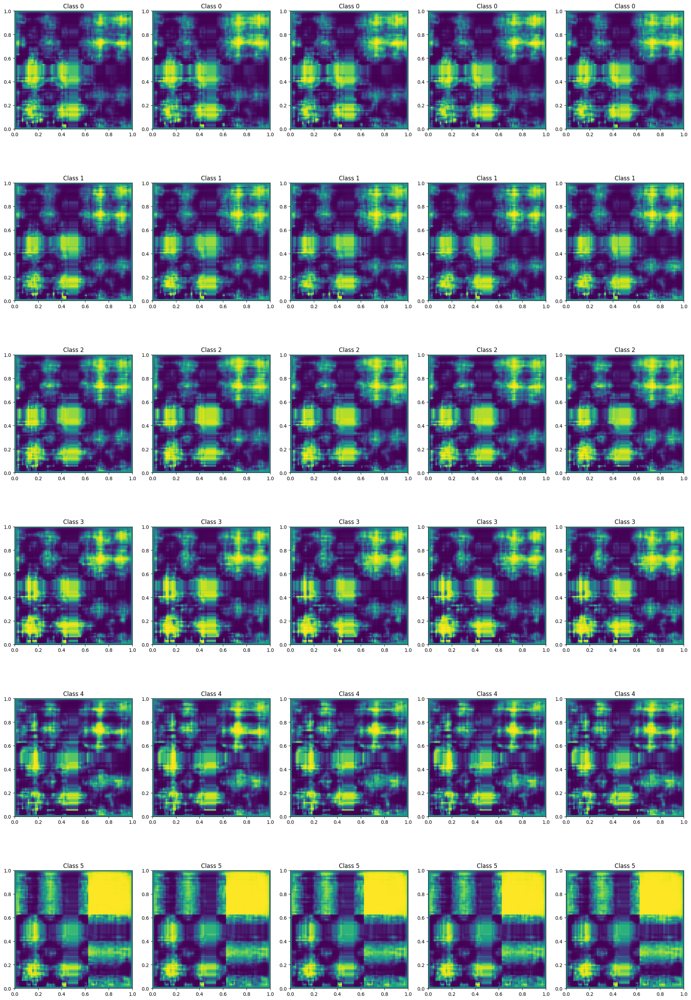

D_Loss: 0.05672341585159302,G_Loss: 0.4419987201690674 :  16%|█▌        | 160/1000 [03:36<16:50,  1.20s/it]   

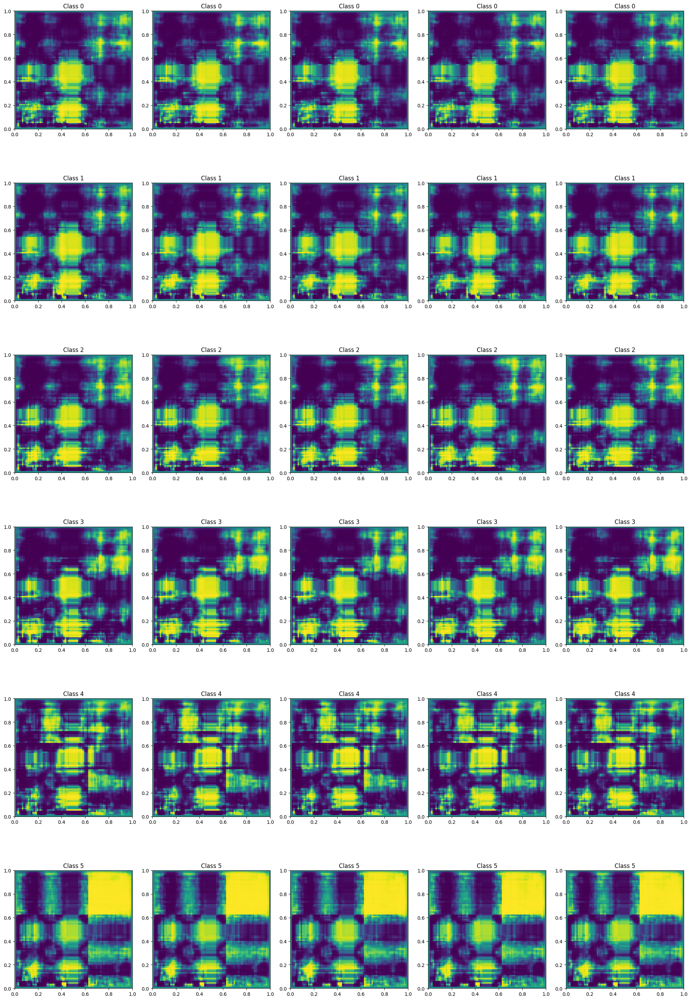

D_Loss: 7.012752030277625e-05,G_Loss: 0.9886325597763062 :  16%|█▋        | 165/1000 [03:43<18:53,  1.36s/it] 


KeyboardInterrupt: 

In [34]:
# ----------
#  Training
# ----------
generator.train()
discriminator.train()
d_losses = []
g_losses = []
progress_bar =  tqdm(range(epochs), desc="Epochs")
for epoch in progress_bar:
    mean_d_losses = []
    mean_g_losses = []
    for batch_idx, (images, labels) in enumerate(train_loader):
        batch_size = images.size(0)

        # Adversarial ground truths
        valid = torch.ones((batch_size, 1), requires_grad=False).to(device)
        fake = torch.zeros((batch_size, 1), requires_grad=False).to(device)

        # Configure input
        real_images = images.type(torch.FloatTensor).to(device)
        labels = labels.type(torch.LongTensor).to(device)

        # -----------------
        #  Train Generator
        # -----------------

        optimizer_G.zero_grad()

        # Sample noise and labels as generator input
        noise = torch.FloatTensor(np.random.normal(0, 1, (batch_size, latent_dim))).to(device)
        # gen_labels = torch.LongTensor([[0, 1] if np.random.choice([True, False]) else [1, 0] for _ in range(batch_size)]).to(device)
        random_integers = np.random.randint(num_classes, size=batch_size)
        one_hot_labels = np.eye(num_classes)[random_integers]
        gen_labels = torch.LongTensor(one_hot_labels).to(device)

        # Generate a batch of sequences
        gen_seqs = generator(noise, gen_labels)

        # Loss measures generator's ability to fool the discriminator
        validity = discriminator(gen_seqs, gen_labels)
        g_loss = adversarial_loss(validity, valid)

        # Append loss to list
        mean_g_losses.append(g_loss.item())

        g_loss.backward()
        optimizer_G.step()

        # if epoch%2 == 0:
        # ---------------------
        #  Train Discriminator
        # ---------------------

        optimizer_D.zero_grad()

        # Loss for real images
        validity_real = discriminator(real_images, labels)
        d_real_loss = adversarial_loss(validity_real, valid)

        # Loss for fake images
        validity_fake = discriminator(gen_seqs.detach(), gen_labels)
        d_fake_loss = adversarial_loss(validity_fake, fake)

        # Total discriminator loss
        d_loss = (d_real_loss + d_fake_loss) / 2

        # Append current loss values to lists
        mean_d_losses.append(d_loss.item())

        d_loss.backward()
        optimizer_D.step()

        progress_bar.set_description(f'D_Loss: {d_loss.item()},G_Loss: {g_loss.item()} ')

    ## Print results every N epochs
    if epoch%20 == 0:
      generator.eval()
      with torch.no_grad():
        
        n_gen = 5  # Set the value of n_gen to a positive integer greater than 0
        noise_sample = torch.FloatTensor(np.random.normal(0, 1, (n_gen, latent_dim))).to(device)
        #Generate
        integers = np.arange(0,num_classes)
        one_hot_labels = np.eye(num_classes)[integers]
        #create plot axs
        fig, axs = plt.subplots(num_classes, n_gen, figsize=(20, 5*num_classes))

        for i in range(num_classes):
          generated_images = generator(noise_sample, torch.LongTensor([one_hot_labels[i]] * n_gen).to(device))
          generated_images_np = generated_images.cpu().detach().numpy().reshape((n_gen,img_size,img_size))

          for k in range(n_gen):
            axs[i,k].imshow(generated_images_np[k], cmap='viridis', origin='lower', extent=[0, 1, 0, 1])
            axs[i,k].set_title(f"Class {i}")

        # Adjust layout
        plt.tight_layout()
        plt.show()

      generator.train()

    d_losses.append(np.mean(mean_d_losses))
    g_losses.append(np.mean(mean_g_losses))


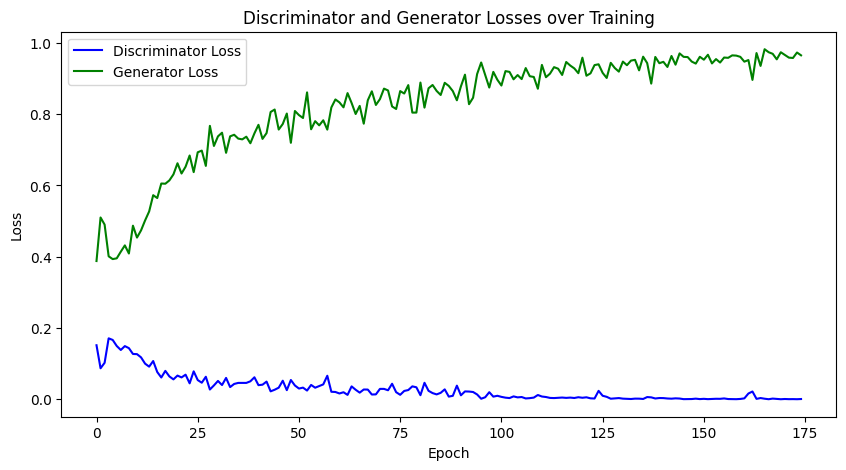

In [24]:
# Plotting discriminator and generator losses
plt.figure(figsize=(10, 5))
plt.plot(d_losses, label='Discriminator Loss', color='blue')
plt.plot(g_losses, label='Generator Loss', color='green')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Discriminator and Generator Losses over Training')
plt.legend()
plt.show()

# Save gen dataset

In [40]:
generator.eval()
with torch.no_grad():
    generated_images_all = []
    labels = []
    n_gen = 50  # number of generations per classes
    noise_sample = torch.FloatTensor(np.random.normal(0, 1, (n_gen, latent_dim))).to(device)
    #Generate
    integers = np.arange(0,num_classes)
    one_hot_labels = np.eye(num_classes)[integers]
    for i in range(num_classes):
        generated_images = generator(noise_sample, torch.LongTensor([one_hot_labels[i]] * n_gen).to(device))
        generated_images_np = generated_images.cpu().detach().numpy().reshape((n_gen,img_size,img_size))
        
        generated_images_all.append(generated_images_np)
        labels.append([one_hot_labels[i]] * n_gen)
    
    generated_images_all = np.array(generated_images_all)
    labels = np.array(labels)
    generated_images_all = generated_images_all.reshape(-1,1,img_size,img_size)
    labels = labels.reshape(-1,num_classes)

    #Save generated images
    np.save('GAN_series.npy', generated_images_all)
    np.save('labels.npy', labels)


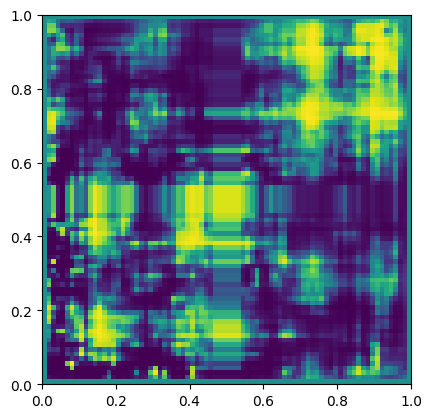

In [4]:
images = np.load('GAN_series.npy')
labels = np.load('labels.npy')

img = images[0][0]
plt.imshow(img, cmap='viridis', origin='lower', extent=[0, 1, 0, 1])

In [7]:
np.min(img)

-1.0

In [ ]:
# Save generator and discriminator weights
torch.save(generator.state_dict(), 'generator_weights_2k.pth')
torch.save(discriminator.state_dict(), 'discriminator_weights_2k.pth')

# Load data from drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
loaded_array = np.load("/content/drive/MyDrive/IA321/concatenated_images.npy")

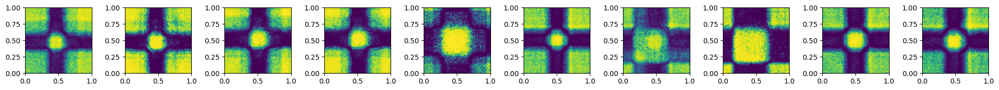

In [ ]:

# Create subplots for Class 1
fig, axs = plt.subplots(1, 10, figsize=(20, 5))
for i in range(10):
    axs[i].imshow(loaded_array[95 + i], cmap='viridis', origin='lower', extent=[0, 1, 0, 1])

# Adjust layout
plt.tight_layout()
plt.show()

In [ ]:
loaded_array_DCGAN = np.load("/content/drive/MyDrive/IA321/gen_images_DCGAN.npy")

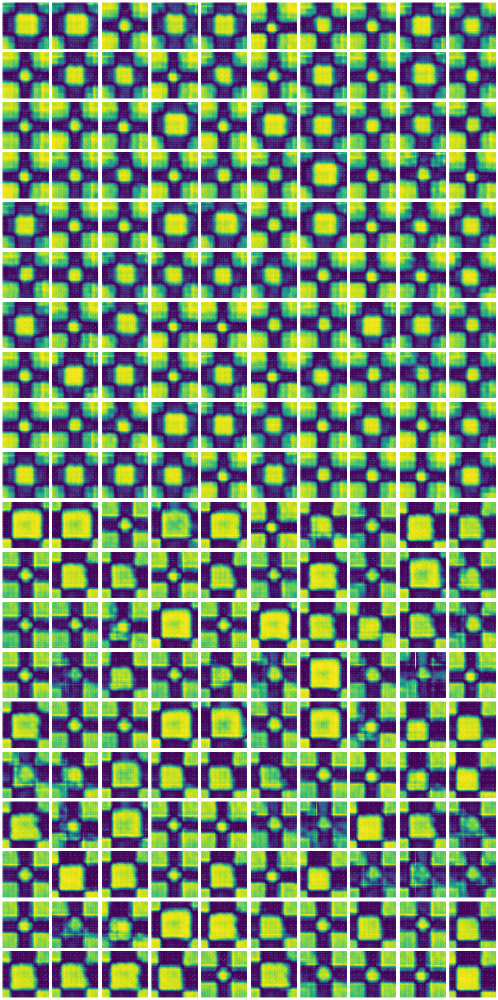

In [ ]:
fig, axs = plt.subplots(20, 10, figsize=(20, 40))

for i in range(20):
    for j in range(10):
        index = i * 10 + j
        axs[i, j].imshow(loaded_array_DCGAN[index], cmap='viridis', origin='lower', extent=[0, 1, 0, 1])
        axs[i, j].axis('off')  # Turn off axis labels to make it cleaner

# Adjust layout
plt.tight_layout()
plt.show()

In [ ]:
loaded_array_UpsampleGAN = np.load("/content/drive/MyDrive/IA321/concatenated_images_UpsampleGAN.npy")

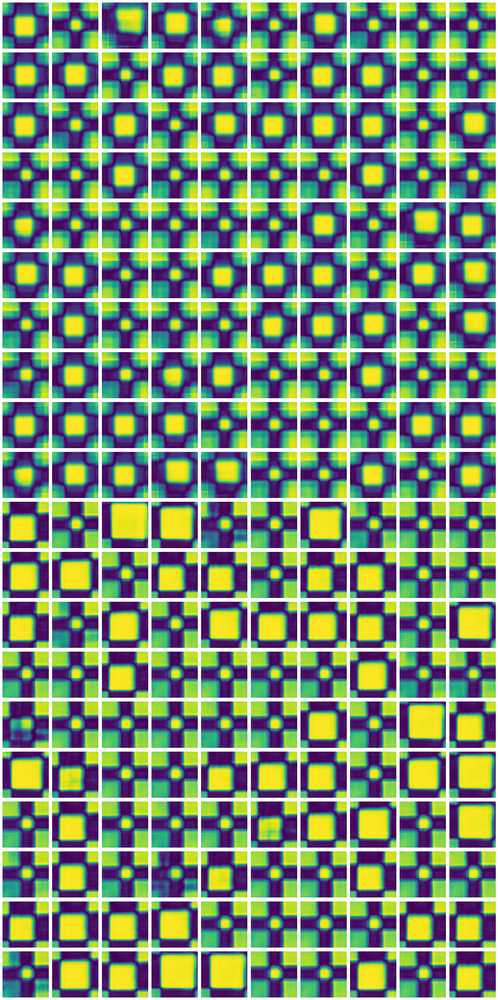

In [ ]:
fig, axs = plt.subplots(20, 10, figsize=(20, 40))

for i in range(20):
    for j in range(10):
        index = i * 10 + j
        axs[i, j].imshow(loaded_array_UpsampleGAN[index], cmap='viridis', origin='lower', extent=[0, 1, 0, 1])
        axs[i, j].axis('off')  # Turn off axis labels to make it cleaner

# Adjust layout
plt.tight_layout()
plt.show()